# Final Report 
Group members: Loay Al-Abri, 

Final Report

We start by loading the required libraries

In [74]:
library(tidyverse)
library(tidymodels)
library(scales)
library(GGally)
library(broom)

In [75]:
repositories <- read_csv("data/repositories.csv")
head(repositories)
nrow <- nrow(repositories)
print(paste("There are a total of ", nrow, "rows"))

Rows: 215029 Columns: 24
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): Name, Description, URL, Homepage, Language, License, Topics, Defau...
dbl  (5): Size, Stars, Forks, Issues, Watchers
lgl  (9): Has Issues, Has Projects, Has Downloads, Has Wiki, Has Pages, Has ...
dttm (2): Created At, Updated At

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Name,Description,URL,Created At,Updated At,Homepage,Size,Stars,Forks,Issues,⋯,Has Issues,Has Projects,Has Downloads,Has Wiki,Has Pages,Has Discussions,Is Fork,Is Archived,Is Template,Default Branch
<chr>,<chr>,<chr>,<dttm>,<dttm>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<chr>
freeCodeCamp,freeCodeCamp.org's open-source codebase and curriculum. Learn to code for free.,https://github.com/freeCodeCamp/freeCodeCamp,2014-12-24 17:49:19,2023-09-21 11:32:33,http://contribute.freecodecamp.org/,387451,374074,33599,248,⋯,TRUE,TRUE,TRUE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,main
free-programming-books,:books: Freely available programming books,https://github.com/EbookFoundation/free-programming-books,2013-10-11 06:50:37,2023-09-21 11:09:25,https://ebookfoundation.github.io/free-programming-books/,17087,298393,57194,46,⋯,TRUE,FALSE,TRUE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,main
awesome,😎 Awesome lists about all kinds of interesting topics,https://github.com/sindresorhus/awesome,2014-07-11 13:42:37,2023-09-21 11:18:22,NA,1441,269997,26485,61,⋯,TRUE,FALSE,TRUE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,main
996.ICU,Repo for counting stars and contributing. Press F to pay respect to glorious developers.,https://github.com/996icu/996.ICU,2019-03-26 07:31:14,2023-09-21 08:09:01,https://996.icu,187799,267901,21497,16712,⋯,FALSE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE,FALSE,master
coding-interview-university,A complete computer science study plan to become a software engineer.,https://github.com/jwasham/coding-interview-university,2016-06-06 02:34:12,2023-09-21 10:54:48,NA,20998,265161,69434,56,⋯,TRUE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE,main
public-apis,A collective list of free APIs,https://github.com/public-apis/public-apis,2016-03-20 23:49:42,2023-09-21 11:22:06,http://public-apis.org,5088,256615,29254,191,⋯,TRUE,FALSE,TRUE,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE,master


[1] "There are a total of  215029 rows"


## Data Cleaning ##

Each observation (a repository) is its row, each column is a variable and each observation is in a cell, so this data is in a tidy format. We should modify the column names so there are no blank spaces between them. We will drop the following columns because they are not relevant to our questions and they represent text data that will make our model complicated :`Name`, `Language`, `Description`, `URL`, `Homepage`, `Topics` and `License`.

In [76]:
#Changing column names
colnames(repositories) <- gsub(" ", "_", colnames(repositories))
repositories <- repositories |>  select(-Name, -Homepage, -URL, -Topics, -License, -Description,-Created_At, -Updated_At, -Language) |>
                                 mutate(Has_Discussions = as.factor(Has_Discussions), 
                                        Has_Issues = as.factor(Has_Issues),
                                        Has_Projects = as.factor(Has_Projects),
                                        Has_Downloads = as.factor(Has_Downloads),
                                        Has_Wiki = as.factor(Has_Wiki), 
                                        Has_Pages= as.factor(Has_Pages), 
                                        Is_Fork = as.factor(Is_Fork), 
                                        Is_Archived = as.factor(Is_Archived), 
                                        Is_Template = as.factor(Is_Template))                              

Since the data is extremely large, we take a sample of size 10000 from the data to reduce the computational time. Before we do our data analysis, we will split the data into training and testing. We keep a 75-25 split for training - testing. 

In [77]:
set.seed(1234)
repos_sample<-  repositories|>
                sample_n(20000, replace = FALSE)
repos_split <- initial_split(repos_sample, prop= 0.75, strata = Stars)
repos_train <- repos_train <- training(repos_split)
repos_train <- repos_train <- training(repos_split)


We will check for any potential_problems in our data 

In [78]:
#Observing if there are any NA values
repos_train_nas <- data.frame(colSums(is.na(repos_train)))
print("Variables that have NA values")
repos_train_nas |> rename(Number_nas = colSums.is.na.repos_train.. ) |> filter(Number_nas > 0)

[1] "Variables that have NA values"


Number_nas
<dbl>


None of the variables have missing values. Let's also get the proportions of the True/False the logical variables of Interest to see if there are any potential issues. 

In [79]:
prop <- function(col) {
    mean(col == TRUE)
}

count_categories <- repos_train|>
                    select(Has_Discussions, Has_Issues, Has_Projects, Has_Downloads, Has_Wiki, Has_Pages, Is_Fork, Is_Archived, Is_Template) |>
                    summarise(across(Has_Discussions: Is_Template, prop))
count_categories
print("Proportion of True Values in the logical variables")

Has_Discussions,Has_Issues,Has_Projects,Has_Downloads,Has_Wiki,Has_Pages,Is_Fork,Is_Archived,Is_Template
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.1283419,0.9683312,0.8659244,0.990466,0.7872525,0.1744116,0,0.06733782,0.005333689


[1] "Proportion of True Values in the logical variables"


In [80]:
repos_summaries <- repos_train |>
                    select_if(is.numeric) |>
                    map_df(mean)
repos_summaries
print("Mean Values of the logical variables")

Size,Stars,Forks,Issues,Watchers
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
51795.82,1101.105,219.3806,38.53397,1101.105


[1] "Mean Values of the logical variables"


We see that there is a lot of imabalance in most logical variables and only variables so from now onwards, we only work with the logical variables  `Has_Wiki`, `Has_Discussions`, `Has_Pages`, `Has_Projects`

In [88]:
repos_train<-  repos_train |>
                select(Stars, Issues, Forks, Size, Has_Discussions, Has_Wiki, Has_Pages, Has_Projects)


## Exploratory Data  Visualistions ##

### Exploring distribution of covariates and response ###

Warning message:
“Removed 232 rows containing non-finite outside the scale range (`stat_bin()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_bar()`).”


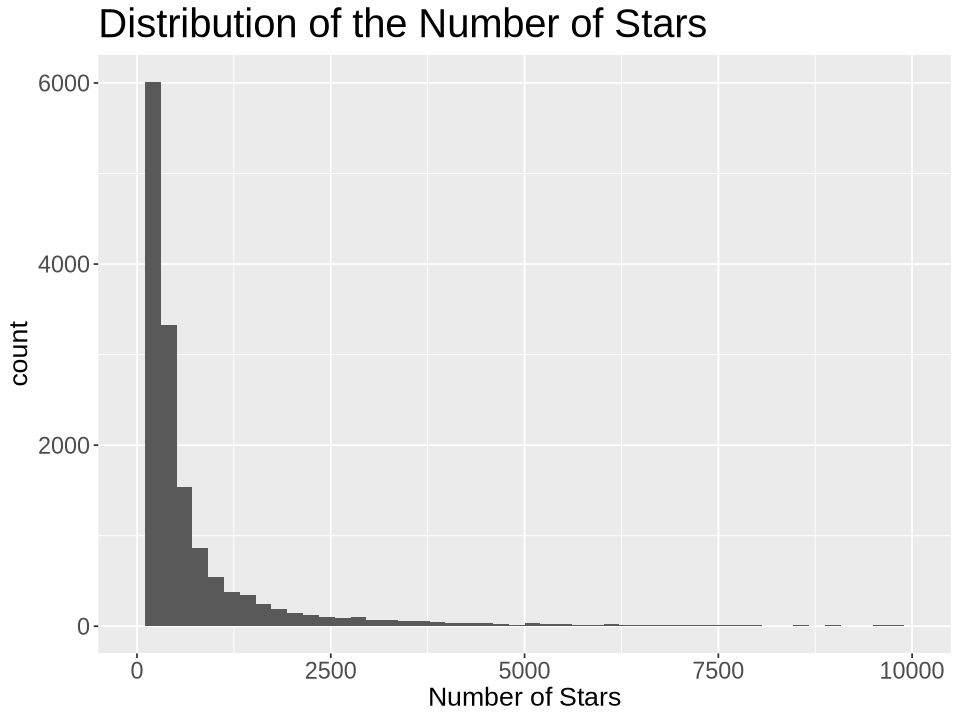

In [89]:
options(repr.plot.width = 8, repr.plot.height = 6)
stars_dist <- repos_train %>%
    ggplot(aes(Stars)) + 
    geom_histogram(bins = 50) + 
    scale_x_continuous(limits = c(0, 10000)) +
    labs(title = "Distribution of the Number of Stars",
    x = "Number of Stars") +
    theme(
    plot.title = element_text(size = 24),
    axis.title = element_text(size = 16),
    axis.text = element_text(size = 14),
  )
stars_dist

The distribution is right-skewed with many extereme values. However, most repositories have the between 0 and 2500 stars. This might leed to poor predictions with the model. We may need to transfrom the response variable using log function. Also, we have a lot of outliers.

### Assessing Relationship between response and covariates ###

We will treat Stars, Forks, Issues and Size as continuous variables for our analysis. Since our goal is to assess the relationship between Stars and the other covariates, and we have one categorical and 3 continuous predictors, we will create a combination of scatter plots. These plots would help us visualise the direction, strength and form of the relationship (linear, quadratic, etc.) between the response and the covariates. 

We now create the following scatterplots:
 - Scatterplot of Stars Vs Issues, stratified on  Has_Discussions (Figure 1)
 - Scatterplot of Stars Vs Forks, stratified on  Has_Discussions (Figure 2)
 - Scatterplot of Stars Vs Size, stratified on  Has_Discussions (Figure 3)

For the plots we transform the x and y axis on a log scale because if we did not do that, we would find a large number of points accumulated in one small region of the graph. 

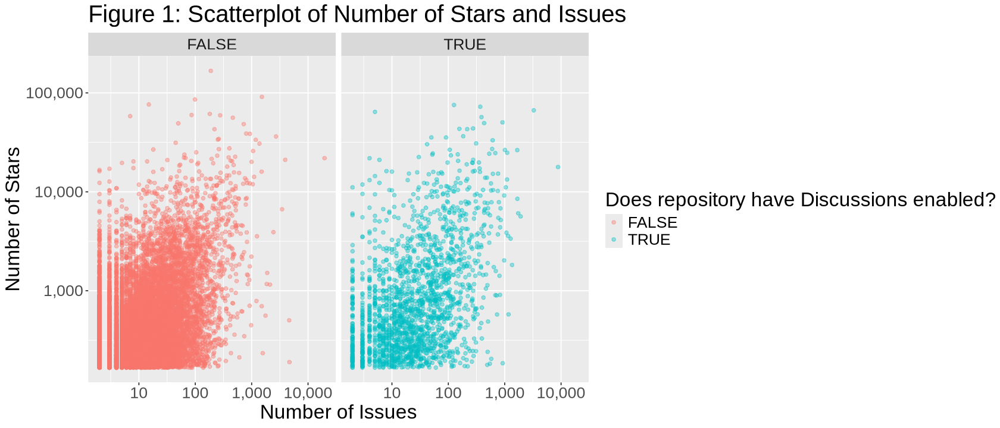

In [90]:
# In order to do log transforms, we add a constant 1 so that x values of 0 do not map to -infinity. 
options(repr.plot.width = 14, repr.plot.height = 6)

repos_train <- repos_train|> mutate(Issues = Issues + 1, Forks = Forks + 1, Size = Size + 1)
stars_issues <- ggplot(repos_train, aes(x = Issues, y = Stars, color =  Has_Discussions)) + 
                     geom_point(alpha = 0.4, size = 1.5) + 
                     ggtitle("Figure 1: Scatterplot of Number of Stars and Issues") + 
                     labs(x = "Number of Issues",y = "Number of Stars", color = "Does repository have Discussions enabled?") +
                     facet_wrap(vars(Has_Discussions)) + 
                     scale_x_continuous(labels = comma, trans = "log10") + 
                     scale_y_continuous(labels = comma, trans = "log10") + 
                     theme(text = element_text(size = 20)) 
        
stars_issues 

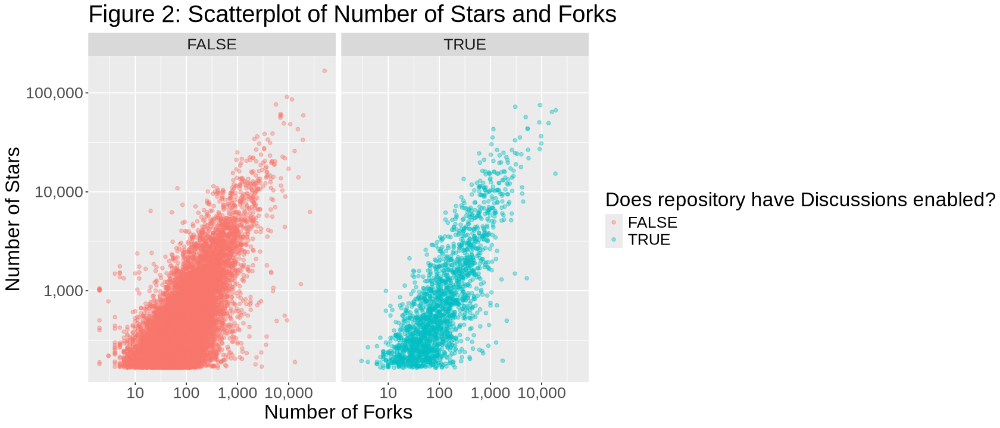

In [91]:
options(repr.plot.width = 14, repr.plot.height = 6)
stars_forks <- ggplot(repos_train, aes(x = Forks, y = Stars, color = Has_Discussions)) + 
                     geom_point(alpha = 0.4, size = 1.5) + 
                     ggtitle("Figure 2: Scatterplot of Number of Stars and Forks") + 
                     labs(x = "Number of Forks", y = "Number of Stars", color = "Does repository have Discussions enabled?") +
                     facet_wrap(vars(Has_Discussions)) + 
                     scale_x_continuous(labels = comma, trans = "log10") + 
                     scale_y_continuous(labels = comma, trans = "log10") + 
                     theme(text = element_text(size = 20)) 
        
stars_forks 

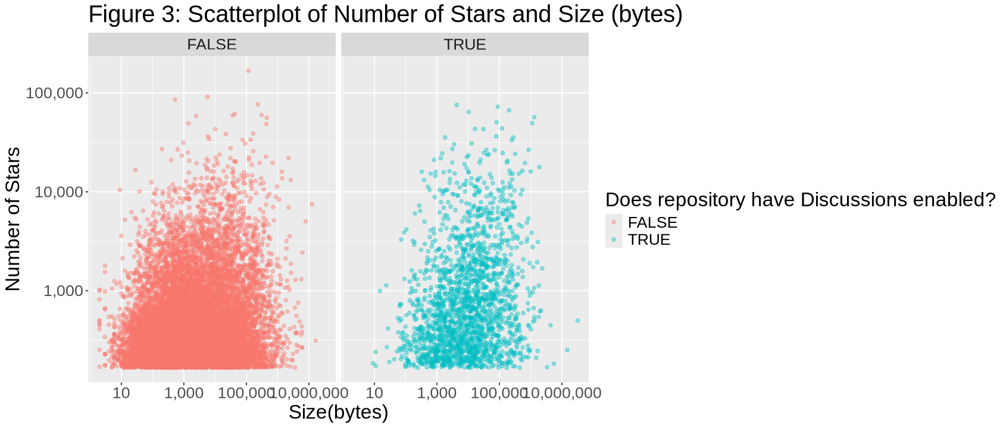

In [92]:
options(repr.plot.width = 14, repr.plot.height = 6)
stars_forks <- ggplot(repos_train, aes(x = Size, y = Stars, color = Has_Discussions)) + 
                     geom_point(alpha = 0.4, size = 1.5) + 
                     ggtitle("Figure 3: Scatterplot of Number of Stars and Size (bytes)") + 
                     labs(x = "Size(bytes)", y = "Number of Stars", color = "Does repository have Discussions enabled?") +
                     facet_wrap(vars(Has_Discussions)) + 
                     scale_x_continuous(labels = comma, trans = "log10") + 
                     scale_y_continuous(labels = comma, trans = "log10") + 
                     theme(text = element_text(size = 20)) 
        
stars_forks 

Warning message:
“Removed 534 rows containing non-finite outside the scale range
(`stat_boxplot()`).”
Warning message:
“Removed 534 rows containing non-finite outside the scale range
(`stat_summary()`).”


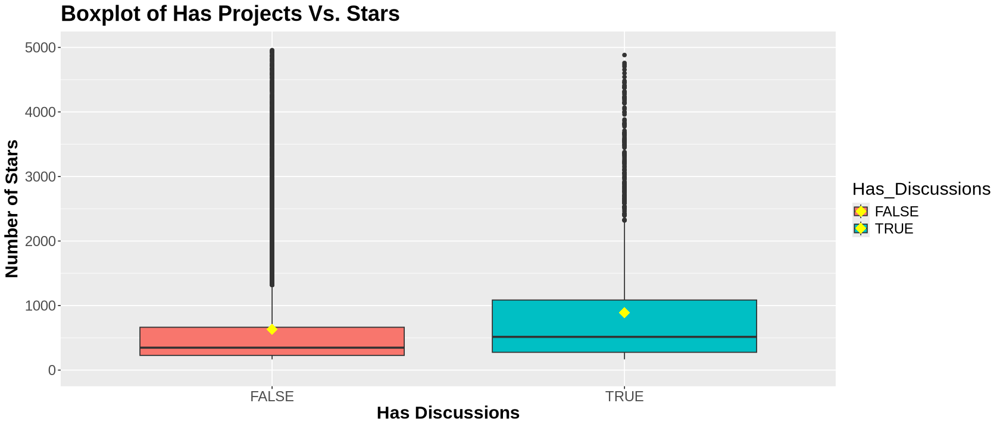

In [93]:
hasProjects_boxplot <- repos_train %>%
    ggplot() +
    geom_boxplot(aes(x = Has_Discussions, y = Stars, fill= Has_Discussions)) + 
    labs(title = "Boxplot of Has Projects Vs. Stars",
    x = "Has Discussions", y = "Number of Stars") + 
    scale_y_continuous(limits = c(0, 5000)) + 
    stat_summary(aes(Has_Discussions, Stars, fill = Has_Discussions),
    fun = mean, colour = "yellow", geom = "point",
    shape = 18, size = 5
    ) +
    theme(
    text = element_text(size = 18),
    plot.title = element_text(face = "bold"),
    axis.title = element_text(face = "bold")
    )

hasProjects_boxplot

Observations from Exploratatory Data Analysis

- It appears number of stars and forks have a moderately strong, positive relationship. The points also seem to lie roughly on a straight line.
- It is unclear whether the number of stars has a relationship with several issues and size.
- The relationship between the categorical variables and the response seems to be similar in both categories: for projects with discussions enabled and not. 
- From the boxplot of Stars vs Has_Discussions, it seems that repositories with discussions enabled tend to have a higher number of stars



### Exploring Presence of any Multicollinearity ##

We will also create a heatmap of correlations between the continuous explanatory variables (Figure 4) to assess any issues with multicollinearity and identify correlated variables. This would help us ensure that we are confident in our coefficient estimates later during our analysis.

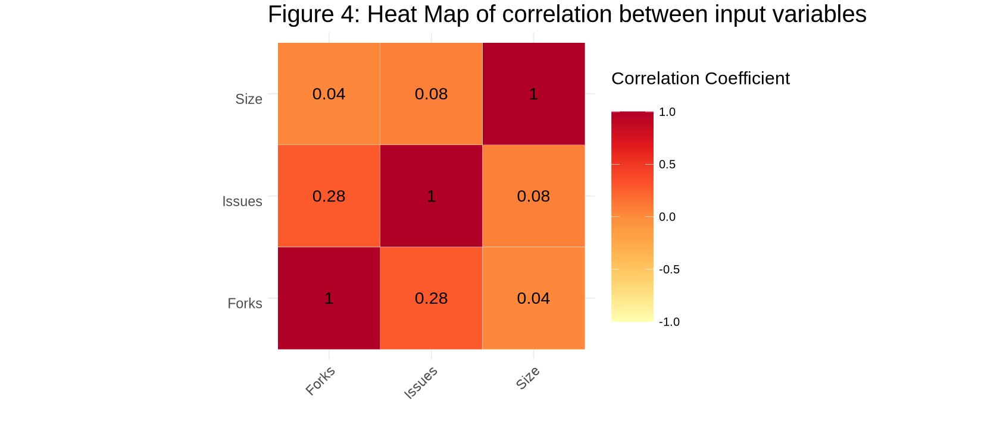

In [94]:
cor_matrix <- repos_train %>%
    select_if(is.numeric) %>%
   select(- Stars) %>% 
   cor() %>%
   as_tibble(rownames = 'var1') %>%
   pivot_longer(-var1, names_to = "var2", values_to = "corr")


plot_cor_matrix <- cor_matrix %>%
    ggplot(aes(var1, var2)) + 
    geom_tile(aes(fill = corr), color = "white") + 
    scale_fill_distiller("Correlation Coefficient \n",
      palette =  "YlOrRd",
      direction = 1, 
      limits = c(-1,1)
    ) +
    labs(x = "", y = "") +
    theme_minimal() +
    theme(
        axis.text.x = element_text(angle = 45, vjust = 1, size = 14, hjust = 1),
        axis.text.y = element_text(vjust = 1, size = 14, hjust = 1),
        legend.title = element_text(size = 18),
        legend.text = element_text(size = 12),
        legend.key.size = unit(1.5, "cm")
    ) +
    coord_fixed() +
    geom_text(aes(var1, var2, label = round(corr, 2)), color = "black", size = 6) + 
    ggtitle("Figure 4: Heat Map of correlation between input variables") + 
    theme(text = element_text(size = 20))


plot_cor_matrix

None of the input variables seem correlated to each other, so we can proceed with our analysis without worrying about multicollinearity. 